★ 표시된 것만 사용해서 총 160배로 증강함 </br>

Data preprocessing
- cropping  (환자 및 기타 정보 제거)

Data augmentation
- flip up and down
- rotate
- average blur, motion blur, edge enhancement (블러 효과 및 선명하게)
- saturation and value control (채도, 밝기 조절)

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
import cv2

In [2]:
data_dir = '/mnt/disk2/data/private_data/SMhospital/capsule/0 data/labeled/190520 p3_2/p3_2'
test = cv2.imread(data_dir + '/hemorrhagic/angioectasia/실한___02-12-20___2032972.jpg')

# Cropping ★ (환자 및 기타 정보 제거)

In [3]:
def cropping(img):
    img = np.array(img, dtype = 'f4')
    img_pre = img[32:544, 32:544, :]
    for i in range(100):
        for j in range(100):
            if i + j > 99:
                pass
            else :
                img_pre[i, j, :] = 0
                img_pre[i, -j, :] = 0
    return img_pre.astype('uint8')

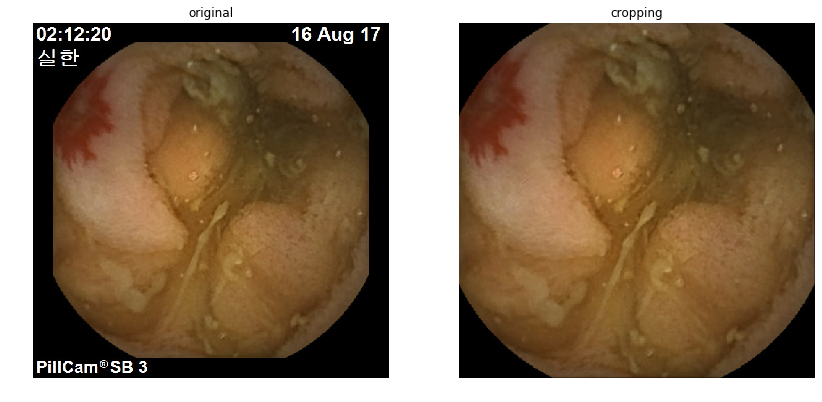

In [4]:
test_crop = cropping(test)

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original')
plt.imshow(cv2.cvtColor(test, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('cropping')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# Flip up and down ★

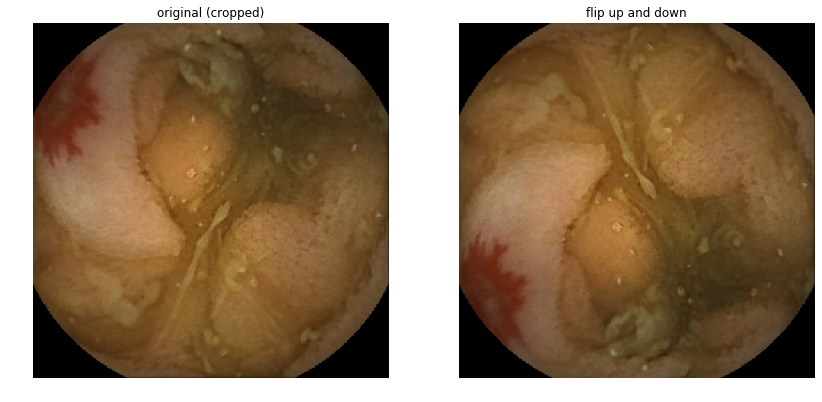

In [7]:
test_f = np.flipud(test_crop)

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('flip up and down')
plt.imshow(cv2.cvtColor(test_f, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# Rotate ★

In [8]:
def rotate(img, degree):
    rows, cols = img.shape[:2]
    M = cv2.getRotationMatrix2D(center = (cols/2, rows/2), angle = degree, scale = 1)
    img_rotated = cv2.warpAffine(img, M, dsize = (rows, cols))
    return img_rotated

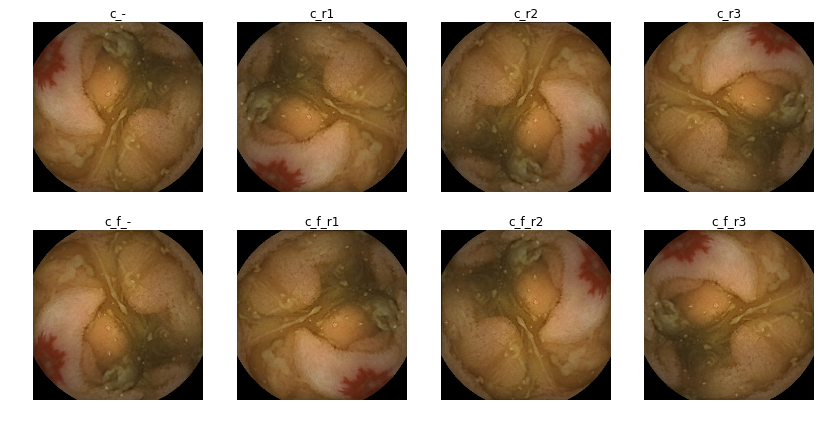

In [9]:
plt.figure(figsize=(14, 7))
for i, c, c_n in zip(range(1,3), [test_crop, test_f], ['c', 'c_f']):
    c_r1, c_r2, c_r3 = rotate(c, 90), rotate(c, 180), rotate(c, 270)
    for j, r, r_n in zip(range(1, 5), [c, c_r1, c_r2, c_r3], ['-', 'r1', 'r2', 'r3']):
        plt.subplot(2, 4, 4*(i-1) + j)
        plt.title('{}_{}'.format(c_n, r_n))
        plt.imshow(cv2.cvtColor(r, cv2.COLOR_BGR2RGB))
        plt.axis('off')
plt.show()

# Blur

## Average Blur ★

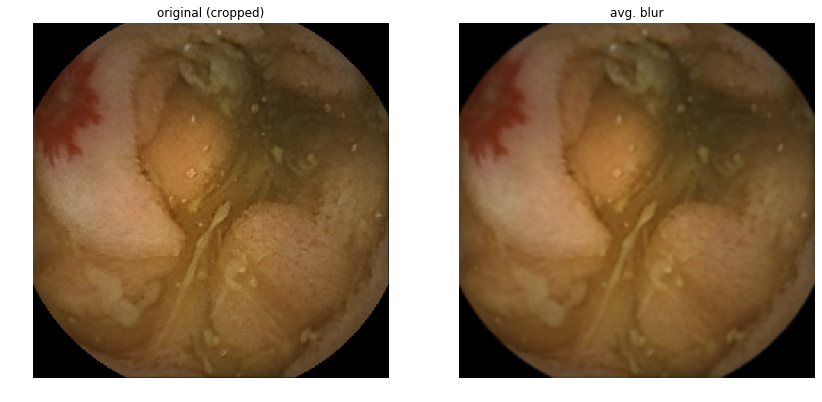

In [10]:
blur = cv2.blur(test_crop, (5,5))

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('avg. blur')
plt.imshow(cv2.cvtColor(blur, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [13]:
zero_index = np.where(test_crop < 7)

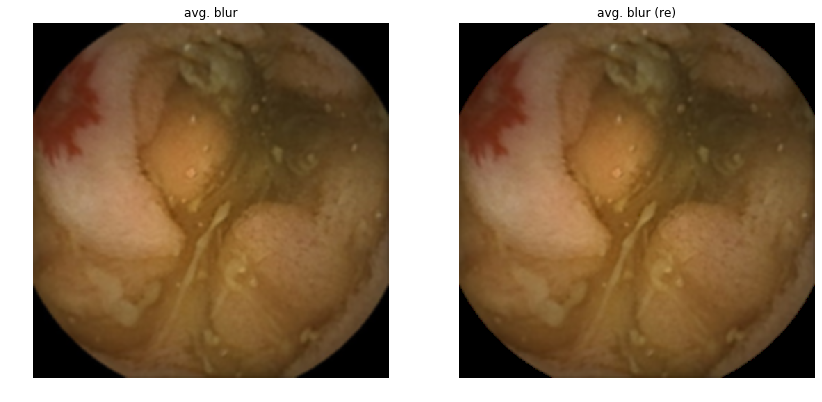

In [15]:
blur_re = blur.copy()
blur_re[zero_index] = 0


plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('avg. blur')
plt.imshow(cv2.cvtColor(blur, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('avg. blur (re)')
plt.imshow(cv2.cvtColor(blur_re, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

## Gaussian Blur

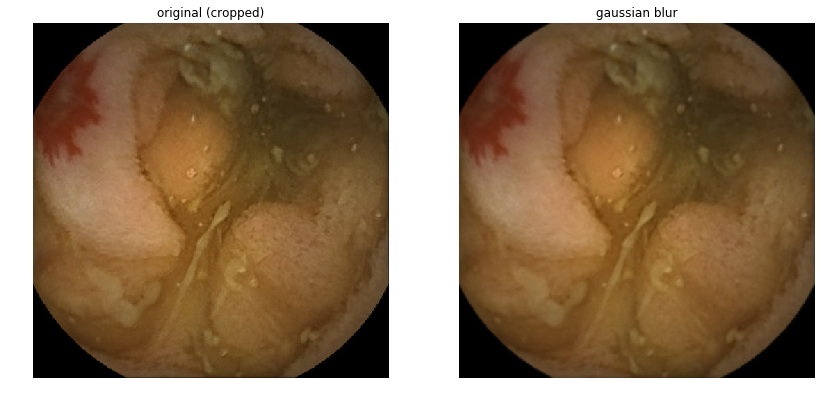

In [573]:
G_blur = cv2.GaussianBlur(test_crop, (5,5), 0)

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('gaussian blur')
plt.imshow(cv2.cvtColor(G_blur, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

## Median Blur

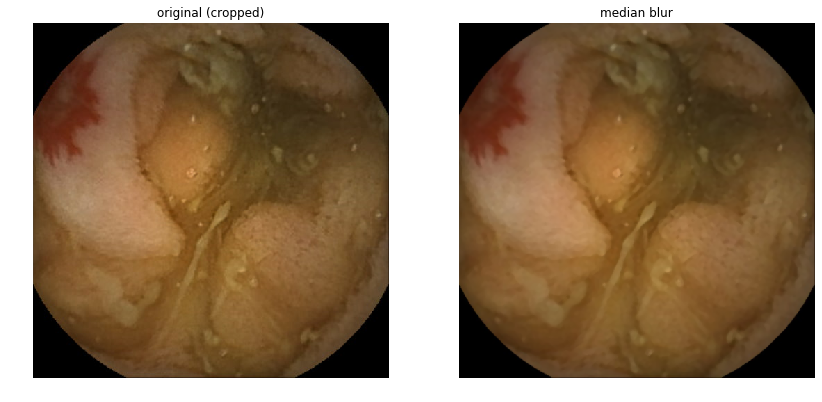

In [574]:
m_blur = cv2.medianBlur(test_crop, 5)

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('median blur')
plt.imshow(cv2.cvtColor(m_blur, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

## Motion Blur ★

In [16]:
def motion_blur(img, kernel_size = 15):
    kernel_motion_blur = np.zeros((kernel_size, kernel_size))
    kernel_motion_blur[int((kernel_size-1)/2), :] = np.ones(kernel_size)
    kernel_motion_blur = kernel_motion_blur / kernel_size
    img_mb = cv2.filter2D(img, -1, kernel_motion_blur)
    return img_mb

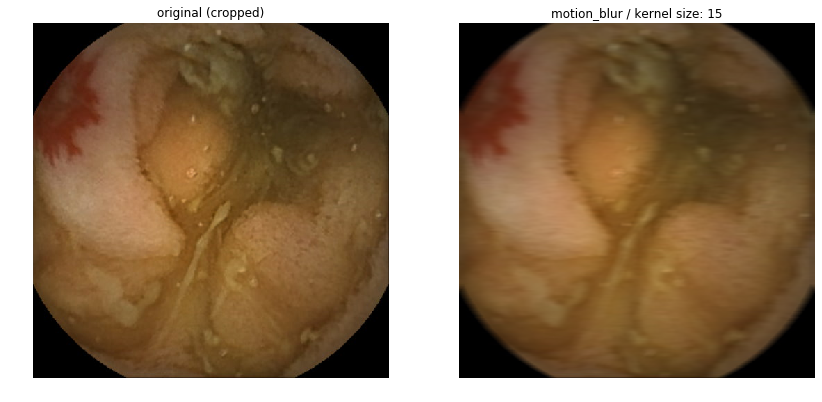

In [17]:
s = 15
test_mb = motion_blur(test_crop, s)

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('motion_blur / kernel size: {}'.format(s))
plt.imshow(cv2.cvtColor(test_mb, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

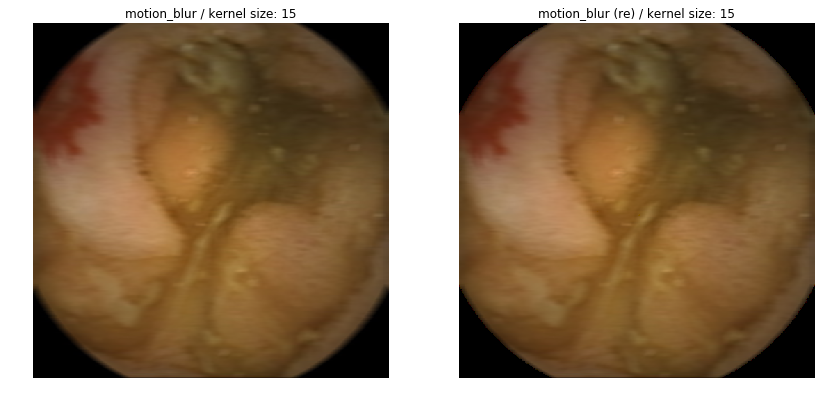

In [19]:
zero_index = np.where(test_crop < 7)
test_mb_re = test_mb.copy()
test_mb_re[zero_index] = 0

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('motion_blur / kernel size: {}'.format(s))
plt.imshow(cv2.cvtColor(test_mb, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('motion_blur (re) / kernel size: {}'.format(s))
plt.imshow(cv2.cvtColor(test_mb_re, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [413]:
sizes = np.arange(15, 46, 5)
sizes

array([15, 20, 25, 30, 35, 40, 45])

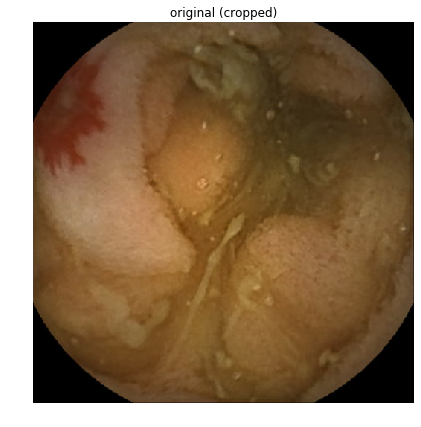

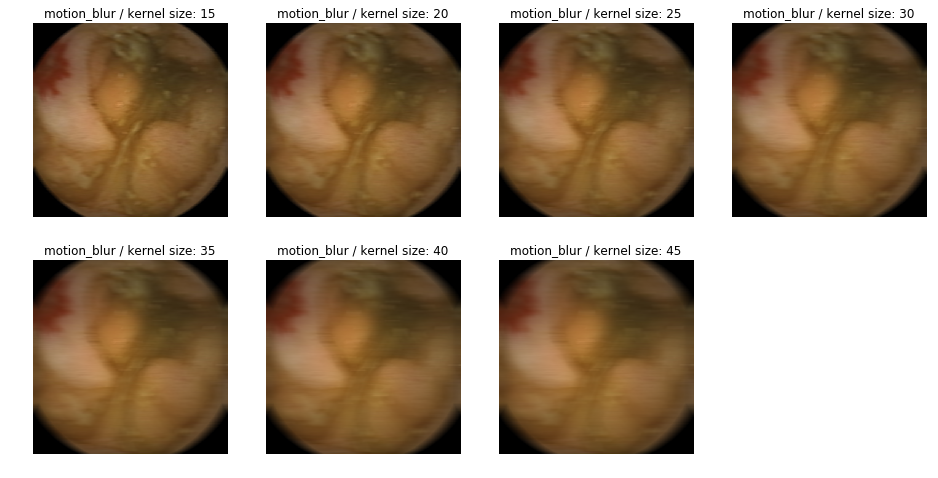

In [564]:
plt.figure(figsize=(14, 7))
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize = (16, 8))
for i, s in zip(range(1, len(sizes)+1), sizes):
    test_mb = motion_blur(test_crop, kernel_size = s)
    plt.subplot(2, 4, i)
    plt.title('motion_blur / kernel size: {}'.format(s))
    plt.imshow(cv2.cvtColor(test_mb, cv2.COLOR_BGR2RGB))
    plt.axis('off')
plt.show()

# Sharpening

## Sharpening

[[-1 -1 -1]
 [-1  9 -1]
 [-1 -1 -1]]


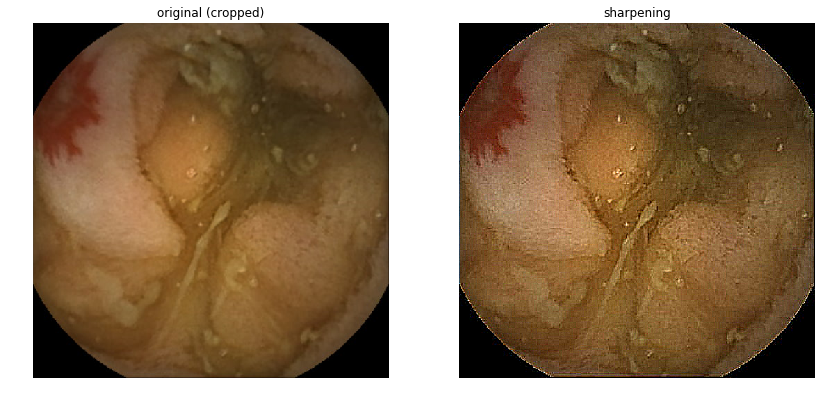

In [579]:
kernel_sharpen_1 = np.array([[-1,-1,-1],[-1,9,-1],[-1,-1,-1]]) 
#정규화를 하지 않은 이유는 모든 값을 다 더하면 1이되기때문에 1로 나눈것과 같은 효과
print(kernel_sharpen_1)

test_sharp = cv2.filter2D(test_crop,-1,kernel_sharpen_1)

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('sharpening')
plt.imshow(cv2.cvtColor(test_sharp, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

## Excessive Sharpening

[[ 1  1  1]
 [ 1 -7  1]
 [ 1  1  1]]


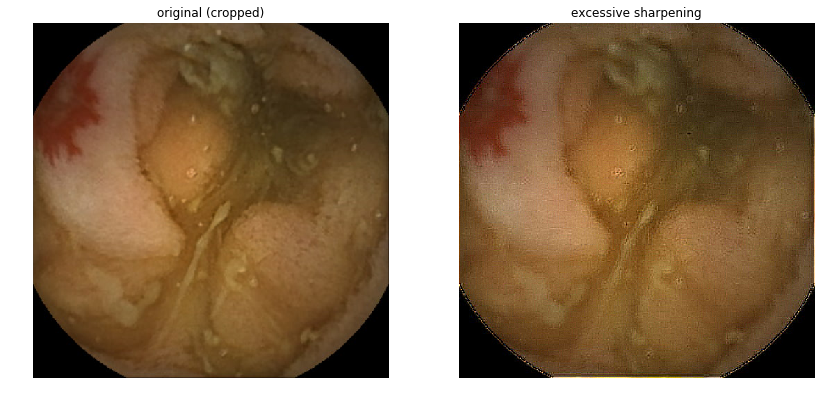

In [578]:
kernel_sharpen_2 = np.array([[1,1,1],[1,-7,1],[1,1,1]])
#정규화를 하지 않은 이유는 모든 값을 다 더하면 1이되기때문에 1로 나눈것과 같은 효과
print(kernel_sharpen_2)

test_ex_sharp = cv2.filter2D(test_crop,-1,kernel_sharpen_2)

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('excessive sharpening')
plt.imshow(cv2.cvtColor(test_ex_sharp, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

## Edge Enhancement ★

[[-0.125 -0.125 -0.125 -0.125 -0.125]
 [-0.125  0.25   0.25   0.25  -0.125]
 [-0.125  0.25   1.     0.25  -0.125]
 [-0.125  0.25   0.25   0.25  -0.125]
 [-0.125 -0.125 -0.125 -0.125 -0.125]]


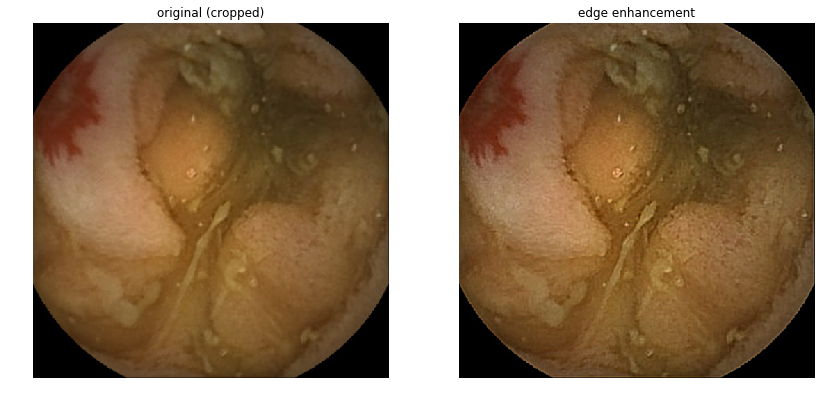

In [586]:
kernel_sharpen_3 = np.array([[-1,-1,-1,-1,-1],[-1,2,2,2,-1],[-1,2,8,2,-1],[-1,2,2,2,-1],[-1,-1,-1,-1,-1]])/8.0
print(kernel_sharpen_3)
test_edge = cv2.filter2D(test_crop,-1,kernel_sharpen_3)

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('edge enhancement')
plt.imshow(cv2.cvtColor(test_edge, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# Erosion / Dilation

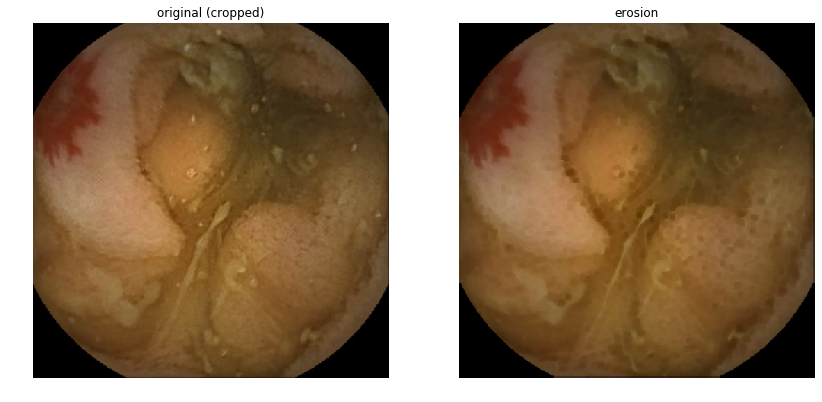

In [587]:
kernel = np.ones((5,5),np.uint8)

test_erosion = cv2.erode(test_crop,kernel,iterations=1)

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('erosion')
plt.imshow(cv2.cvtColor(test_erosion, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

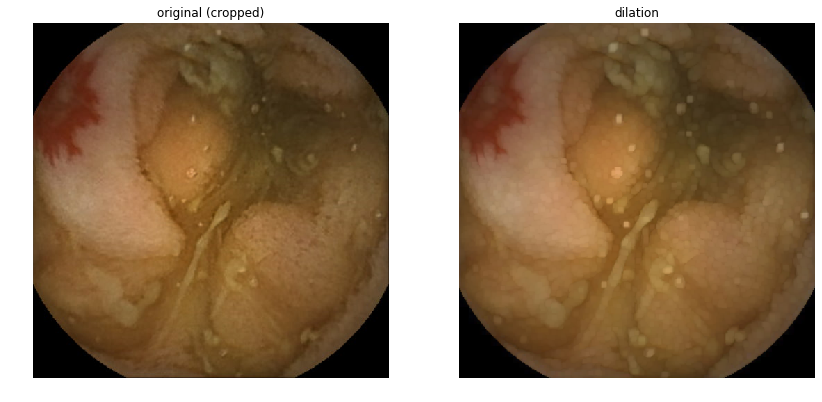

In [588]:
test_dilation = cv2.dilate(test_crop, kernel,iterations=1)

plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('dilation')
plt.imshow(cv2.cvtColor(test_dilation, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# Vignette

In [585]:
rows,cols = test_crop.shape[:2]

kernel_x = cv2.getGaussianKernel(cols,200)
kernel_y = cv2.getGaussianKernel(rows,200)
kernel = kernel_y * kernel_x.T
mask = 235 * kernel / np.linalg.norm(kernel)

test_vignette = np.copy(test_crop)

#applying the mask to eah channel in the input image
for i in range(3):
    test_vignette[:,:,i] = test_vignette[:,:,i] * mask

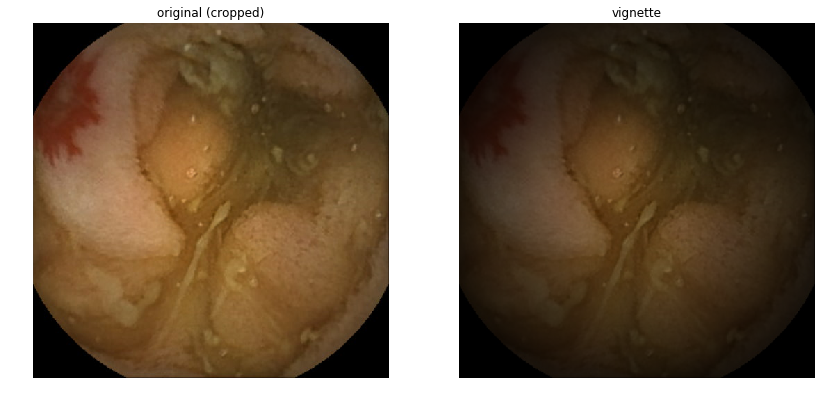

In [589]:
plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('vignette')
plt.imshow(cv2.cvtColor(test_vignette, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# Histogram Equalization

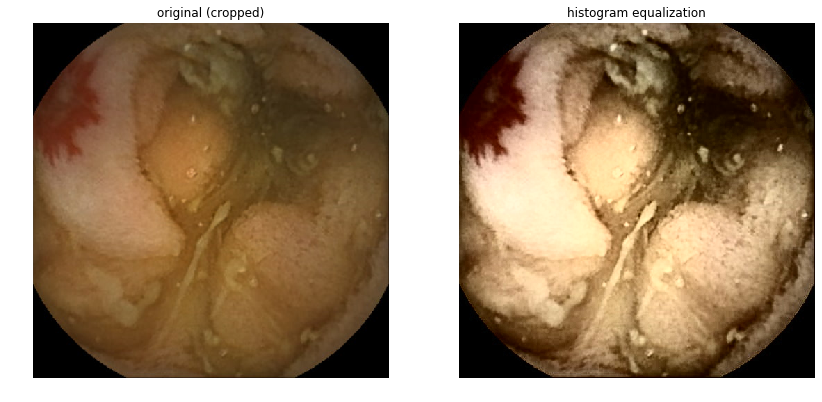

In [590]:
# only test_he = cv2.equalizeHist(test) for gray channel


# color
#BGR을 YUV로 바꿔주기
test_yuv = cv2.cvtColor(test_crop,cv2.COLOR_BGR2YUV)
#y채널을 균일화해주기
test_yuv[:,:,0] = cv2.equalizeHist(test_yuv[:,:,0])
#yuv를 다시 bgrf로 바꿔주기
test_he = cv2.cvtColor(test_yuv,cv2.COLOR_YUV2BGR)


plt.figure(figsize=(14, 7))
plt.subplot(121)
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(122)
plt.title('histogram equalization')
plt.imshow(cv2.cvtColor(test_he, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

# HSV control

In [728]:
def bgr2_h_s_v(img):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)
    return h, s, v

def hsv_control(ch_data, ctr_value, ch_name):
    """
    ch_data: data of channel (h, s, or v) which you want to revise by ctr_value / shape: image.shape[0:2]
    ctr_value: the value that will be added to corresponding channel.
    ch_name: 'h', 's', or 'v'
    """
    ch_data_rev = ch_data.copy()
    if ctr_value > 0:
        ch_data_rev[np.where(ch_data <= 255 - ctr_value)] += ctr_value
    else:
        ch_data_rev[np.where(ch_data + ctr_value >= 0)] -= abs(ctr_value)
    if ch_name == 'v':
        ch_data_rev[np.where(ch_data_rev <= 7)] = 0
    return ch_data_rev

## Saturation (채도조절)

In [637]:
cv2.split?

In [592]:
ctr_values = np.arange(-50, 51, 20)
ctr_values = ctr_values[np.where(ctr_values != 0)[0]]

In [655]:
h, s, v = bgr2_h_s_v(test_crop)

In [682]:
np.where(s + ctr_value >= 0)

(array([  0,   0,   0, ..., 511, 511, 511]),
 array([111, 112, 113, ..., 398, 399, 400]))

In [683]:
ctr_value = -30

s_rev = s.copy()

if ctr_value > 0:
    s_rev[np.where(s <= 255 - ctr_value)] += ctr_value
if ctr_value < 0:
    s_rev[np.where(s + ctr_value >= 0)] -= abs(ctr_value)

In [684]:
test_sv = cv2.merge((h, s_rev, v))


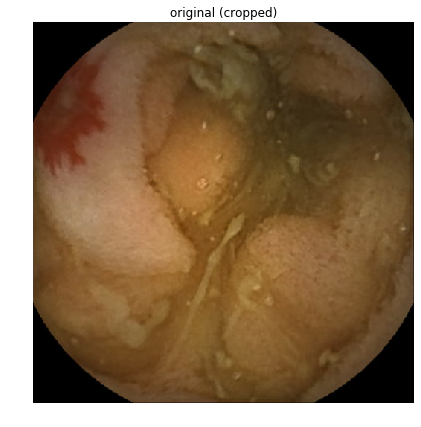

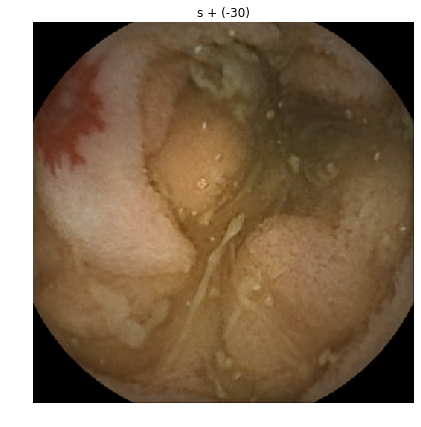

In [685]:
plt.figure(figsize=(7, 7))
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize=(7, 7))
plt.title('s + ({})'.format(ctr_value))
plt.imshow(cv2.cvtColor(test_sv, cv2.COLOR_HSV2RGB))
plt.axis('off')
plt.show()

In [695]:
ctr_values = np.arange(-50, 51, 20)
ctr_values = ctr_values[np.where(ctr_values != 0)[0]]

In [696]:
ctr_values

array([-50, -30, -10,  10,  30,  50])

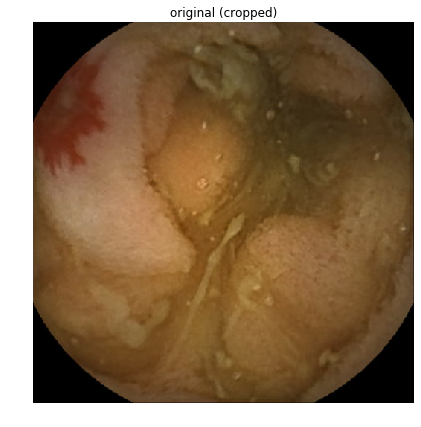

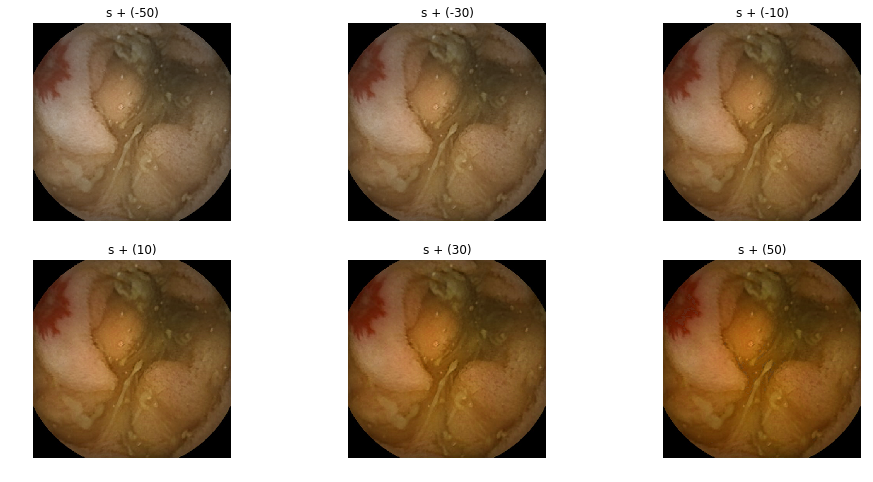

In [698]:
plt.figure(figsize=(7, 7))
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize = (16, 8))
h, s, v = bgr2_h_s_v(test_crop)
for i, ctr_value in zip(range(1, len(ctr_values)+1), ctr_values):
    s_rev = hsv_control(s, ctr_value, ch_name = 's')
    test_s_rev = cv2.merge((h, s_rev, v))
    
    plt.subplot(2, 3, i)
    plt.title('s + ({})'.format(ctr_value))
    plt.imshow(cv2.cvtColor(test_s_rev, cv2.COLOR_HSV2RGB))
    plt.axis('off')
plt.show()

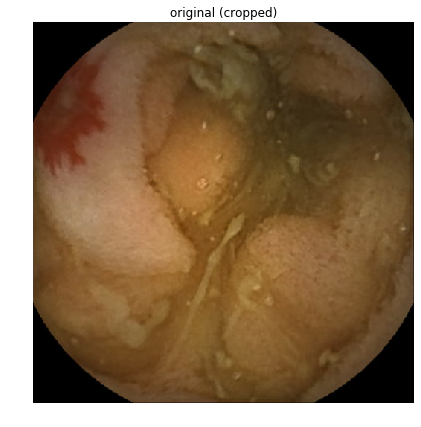

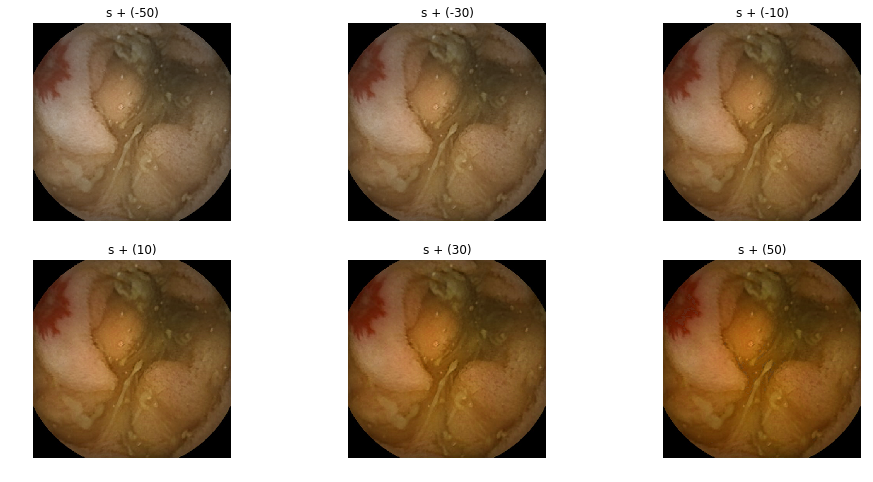

In [594]:
plt.figure(figsize=(7, 7))
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize = (16, 8))
h, s, v = bgr2_h_s_v(test_crop)
for i, ctr_value in zip(range(1, len(ctr_values)+1), ctr_values):
    s_rev = hsv_control(s, ctr_value, ch_name = 's')
    test_s_rev = cv2.merge((h, s_rev, v))
    
    plt.subplot(2, 3, i)
    plt.title('s + ({})'.format(ctr_value))
    plt.imshow(cv2.cvtColor(test_s_rev, cv2.COLOR_HSV2RGB))
    plt.axis('off')
plt.show()

## Value (Brightness, 밝기조절)

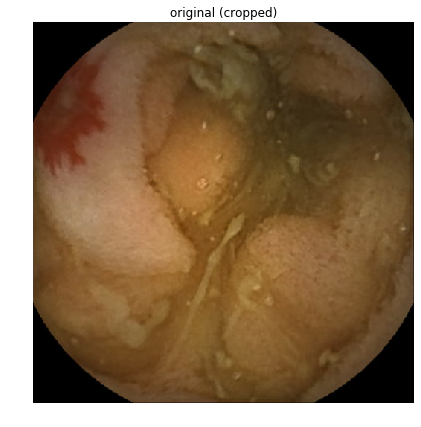

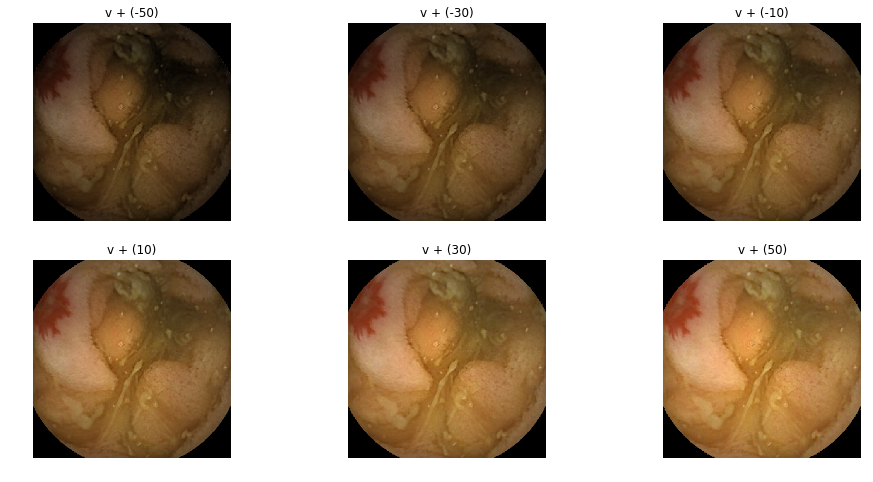

In [714]:
plt.figure(figsize=(7, 7))
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize = (16, 8))
h, s, v = bgr2_h_s_v(test_crop)
for i, ctr_value in zip(range(1, len(ctr_values)+1), ctr_values):
    v_rev = hsv_control(v, ctr_value, ch_name = 'v')
    v_rev[np.where(v <= 7)] = 0
    test_v_rev = cv2.merge((h, s, v_rev))
    
    plt.subplot(2, 3, i)
    plt.title('v + ({})'.format(ctr_value))
    plt.imshow(cv2.cvtColor(test_v_rev, cv2.COLOR_HSV2RGB))
    plt.axis('off')
plt.show()

## H

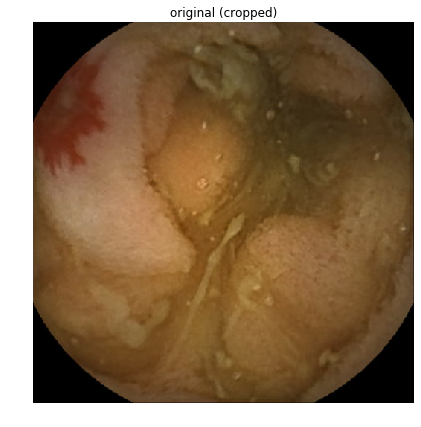

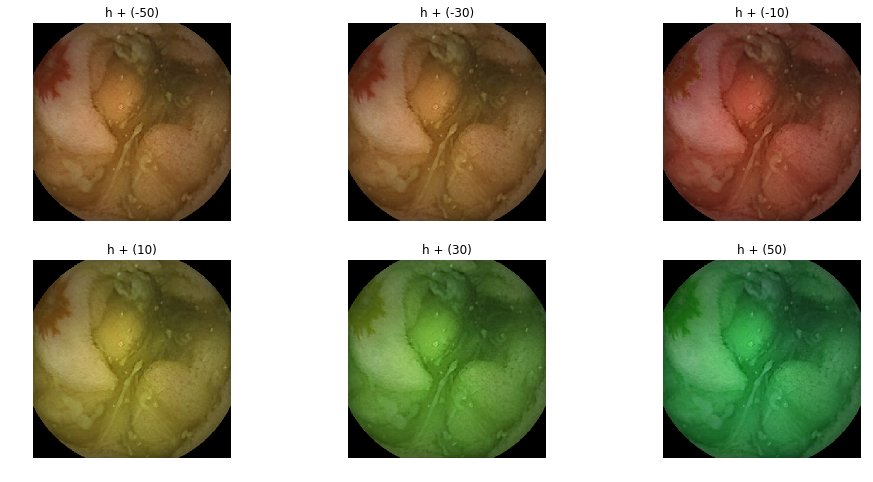

In [715]:
plt.figure(figsize=(7, 7))
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize = (16, 8))
h, s, v = bgr2_h_s_v(test_crop)
for i, ctr_value in zip(range(1, len(ctr_values)+1), ctr_values):
    h_rev = hsv_control(h, ctr_value, ch_name = 'h')
    test_h_rev = cv2.merge((h_rev, s, v))
    
    plt.subplot(2, 3, i)
    plt.title('h + ({})'.format(ctr_value))
    plt.imshow(cv2.cvtColor(test_h_rev, cv2.COLOR_HSV2RGB))
    plt.axis('off')
plt.show()

## S, V ★

In [724]:
ctr_values = np.arange(-50, 51, 20)
ctr_values = ctr_values[np.where(ctr_values != 0)[0]]

In [725]:
ctr_values

array([-50, -30, -10,  10,  30,  50])

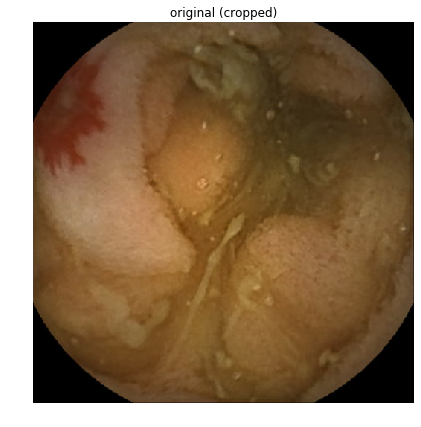

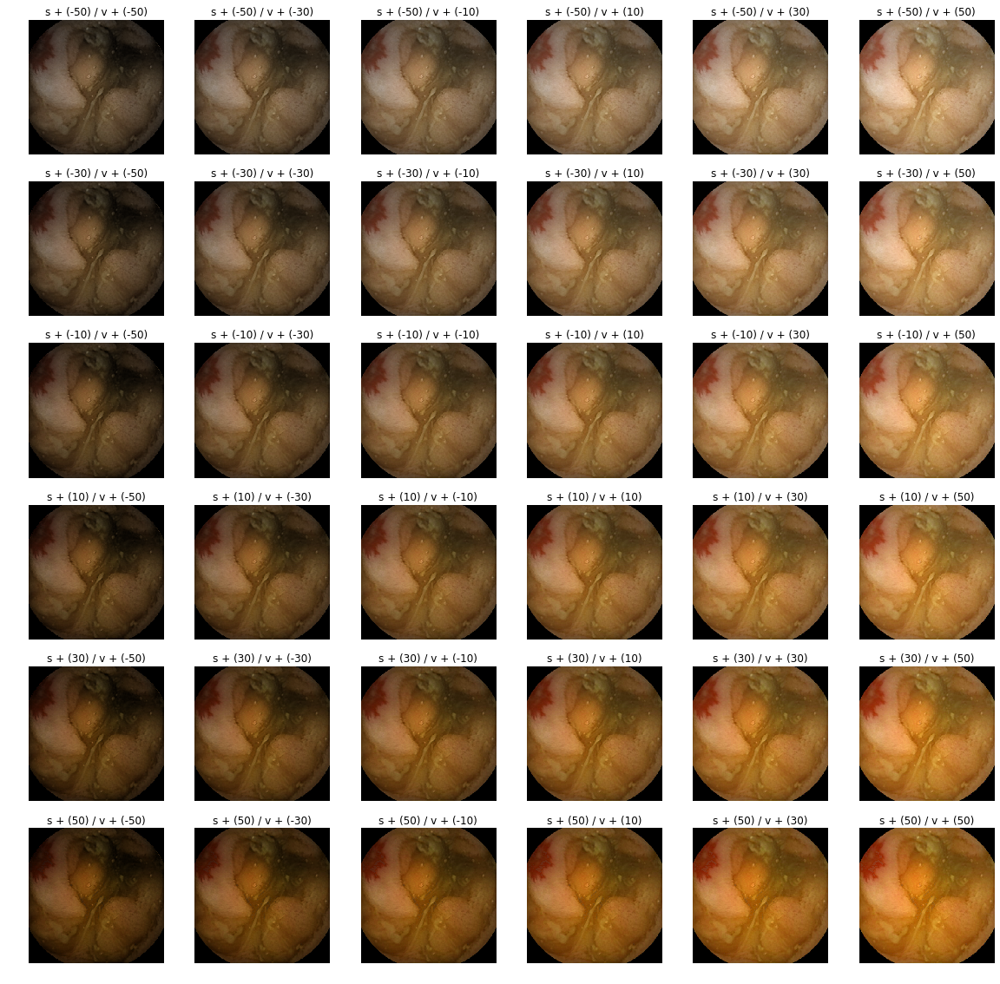

In [726]:
plt.figure(figsize=(7, 7))
plt.title('original (cropped)')
plt.imshow(cv2.cvtColor(test_crop, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

plt.figure(figsize = (20, 20))
h, s, v = bgr2_h_s_v(test_crop)
for i, s_value in zip(range(1, len(ctr_values)+1), ctr_values):
    s_rev = hsv_control(s, s_value, ch_name = 's')
    for j, v_value in zip(range(1, len(ctr_values)+1), ctr_values):
        v_rev = hsv_control(v, v_value, ch_name = 'v')
        v_rev[np.where(v <= 7)] = 0
        test_rev = cv2.merge((h, s_rev, v_rev))

        plt.subplot(6, 6, 6*(i-1) + j)
        plt.title('s + ({}) / v + ({})'.format(s_value, v_value))
        plt.imshow(cv2.cvtColor(test_rev, cv2.COLOR_HSV2RGB))
        plt.axis('off')
plt.show()

# Data Preprocessing using Above Methods

In [1289]:
class ce_preprocessing:
    def __init__(self, data_dir, save_dir):
        self.data_dir = data_dir
        self.save_dir = save_dir

    def cropping(self, img):
        img = np.array(img, dtype = 'f4')
        img_pre = img[32:544, 32:544, :]
        for i in range(100):
            for j in range(100):
                if i + j > 99:
                    pass
                else :
                    img_pre[i, j, :] = 0
                    img_pre[i, -j, :] = 0
        return img_pre.astype('uint8')

    def rotate(self, img, degree):
        rows, cols = img.shape[:2]
        M = cv2.getRotationMatrix2D(center = (cols/2, rows/2), angle = degree, scale = 1)
        img_rotated = cv2.warpAffine(img, M, dsize = (rows, cols))
        return img_rotated
    
    def blur(self, img):
        img_avg_blur = cv2.blur(img, (5,5)).astype('uint8')
        
        kernel_size = 15
        
        kernel_motion_blur = np.zeros((kernel_size, kernel_size))
        kernel_motion_blur[int((kernel_size-1)/2), :] = np.ones(kernel_size)
        kernel_motion_blur = kernel_motion_blur / kernel_size
        img_mb = cv2.filter2D(img, -1, kernel_motion_blur).astype('uint8')
        
        kernel_edge = np.array([[-1,-1,-1,-1,-1],[-1,2,2,2,-1],[-1,2,8,2,-1],[-1,2,2,2,-1],[-1,-1,-1,-1,-1]])/8.0
        img_edge = cv2.filter2D(img, -1, kernel_edge).astype('uint8')    
        return img_avg_blur, img_mb, img_edge
    
    def bgr2_h_s_v(self, img):
        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(hsv)
        return h, s, v

    def hsv_control(self, ch_data, ctr_value, ch_name):
        """
        ch_data: data of channel (h, s, or v) which you want to revise by ctr_value / shape: image.shape[0:2]
        ctr_value: the value that will be added to corresponding channel.
        ch_name: 'h', 's', or 'v'
        """
        ch_data_rev = ch_data.copy()
        if ctr_value > 0:
            ch_data_rev[np.where(ch_data <= 255 - ctr_value)] += ctr_value
        else:
            ch_data_rev[np.where(ch_data + ctr_value >= 0)] -= abs(ctr_value)
        return ch_data_rev
    
    def printProgress(self, iteration, total, prefix = '', suffix = '', decimals = 1, barLength = 100):
        formatStr = "{0:." + str(decimals) + "f}"
        percent = formatStr.format(100 * (iteration / float(total)))
        filledLength = int(round(barLength * iteration / float(total)))
        bar = '#' * filledLength + '-' * (barLength - filledLength)
        sys.stdout.write('\r{} |{} | {}{} {}'.format(prefix, bar, percent, '%', suffix)),
        if iteration == total:
            sys.stdout.write('\n')
        sys.stdout.flush()

    def pre_aug(self, img, phase = 'x160'):  
        preprocessed_imgs = []
        preprocessed_nots = []
        
        crop = self.cropping(img)
        if phase == 'crop':
            return [crop], ['c']
        else:
            sv_ctr_values = [-30, 30]
            crop_f = np.flipud(crop)
            for c,  c_n in zip([crop, crop_f], ['c_-', 'c_f']):
                c_r1, c_r2, c_r3 = self.rotate(c, 90), self.rotate(c, 180), self.rotate(c, 270)
                for r, r_n in zip([c, c_r1, c_r2, c_r3], ['-', 'r1', 'r2', 'r3']):  
                    r_ab, r_mb, r_edge = self.blur(r)
                    for b, b_n in zip([r, r_ab, r_mb, r_edge], ['-', 'ab', 'mb', 'eh']):                    
                        preprocessed_imgs.append(b)
                        not_ = '_{}_{}_{}'.format(c_n, r_n, b_n)
                        preprocessed_nots.append(not_) 
                        h, s, v = self.bgr2_h_s_v(b)
                        for s_value in sv_ctr_values:
                            s_rev = self.hsv_control(s, s_value, ch_name = 's')
                            for v_value in sv_ctr_values:
                                v_rev = self.hsv_control(v, v_value, ch_name = 'v')
                                v_rev[np.where(v <= 7)] = 0
                                b_sv = cv2.merge((h, s_rev, v_rev))
                                b_sv = cv2.cvtColor(b_sv, cv2.COLOR_HSV2BGR)
                                preprocessed_imgs.append(b_sv)
                                not_ = '_{}_{}_{}_s_{}_v_{}'.format(c_n, r_n, b_n, s_value, v_value)
                                preprocessed_nots.append(not_) 
            return preprocessed_imgs, preprocessed_nots
    
    
    def pre_aug_and_save(self, phase, cls, les, filename, preprosseing_phase = 'x160'):
        
        """
        phase = 'train', 'test'
        cls: [les]  
          'n': ['neg']
          'h': ['redspot', 'angio', 'active'], 
          'd': ['ero', 'ulc', 'str'],
          'p': ['amp', 'lym', 'tum']}
        """
        lesions = dict(neg = 'negative', 
                       redspot = 'red_spot', angio = 'angioectasia', active = 'active_bleeding', 
                       ero = 'erosion', ulcer = 'ulcer', str = 'stricture', 
                       amp = 'ampulla_of_vater', lym = 'lymphoid_follicles', tum = 'small_bowel_tumor')
        classes = dict(n = 'negative', h = 'hemorrhagic', d = 'depressed', p = 'protruded')
        
        save_path = os.path.join(self.save_dir, phase, classes[cls], lesions[les])
        import_path = os.path.join(self.data_dir, classes[cls], lesions[les])
        
        for i, f in zip(range(1, len(filename)+1), filename) :
            img = cv2.imread(import_path + '/' + f)
            p_imgs, p_nots = self.pre_aug(img, phase = preprosseing_phase)  
            for img_, not_ in zip(p_imgs, p_nots):
                cv2.imwrite(os.path.join(save_path, '{}_{}{}'.format(f[:-4], not_, f[-4:])), img_)
            self.printProgress(i, len(filename), prefix = classes[cls] + '/' + lesions[les])

In [1290]:
data_dir = '/mnt/disk2/data/private_data/SMhospital/capsule/0 data/labeled/190520 p3_2/p3_2'
neg_2_dir = '/mnt/disk2/data/private_data/SMhospital/capsule/0 data/labeled/190814 negative/raw'
save_dir =  '/mnt/disk2/data/private_data/SMhospital/capsule/1 preprocessed/sm_x'

ce_pre = ce_preprocessing(data_dir, save_dir)

In [823]:
test_pre, pre_name = ce_pre.pre_aug(test)

In [824]:
len(test_pre)

160

In [825]:
(1+1) * (1+3) * (1+3) * (1+4)

160

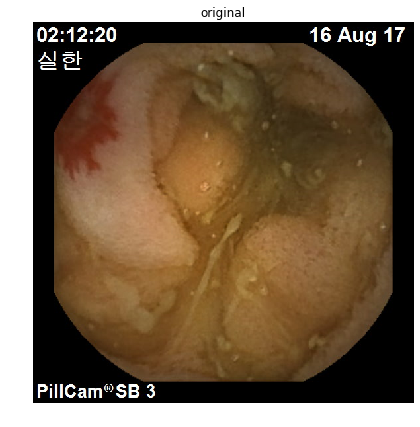

                                  ||           average blur (ab)     ||          motion blur (mb)       ||       edge enhancement (eh)
   (cropped)                      ||
   rotate 90 (r1)                 ||
   rotate 180 (r2)                ||
   rotate 270 (r3)                ||
   flip up and down (f)           ||
   f + r1                         ||
   f + r2                         ||
   f + r3                         ||


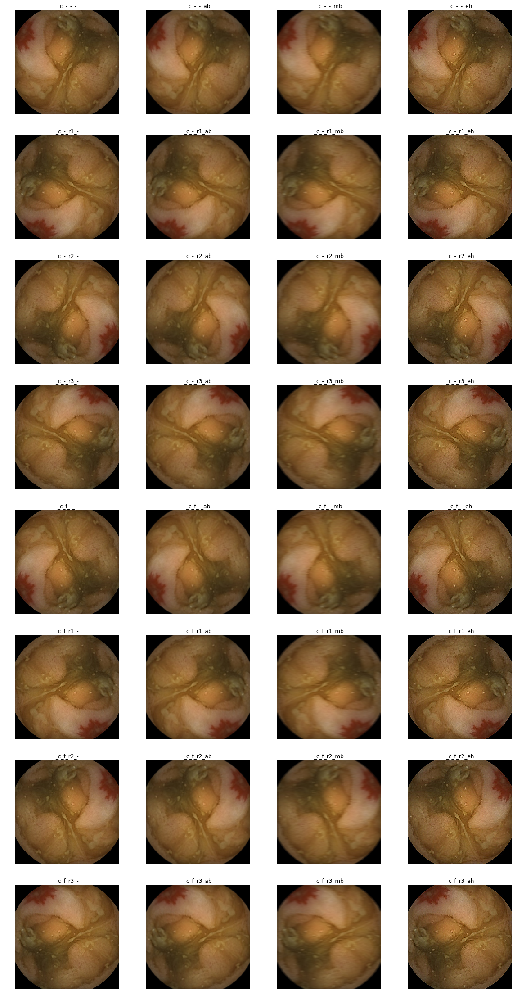

In [835]:
plt.figure(figsize=(7, 7))
plt.title('original')
plt.imshow(cv2.cvtColor(test, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

print("                                  ||           average blur (ab)     ||          motion blur (mb)       ||       edge enhancement (eh)")
print("   (cropped)                      ||")
print("   rotate 90 (r1)                 ||")
print("   rotate 180 (r2)                ||")
print("   rotate 270 (r3)                ||")
print("   flip up and down (f)           ||")
print("   f + r1                         ||")
print("   f + r2                         ||")
print("   f + r3                         ||")


plt.figure(figsize = (20, 40))
for i, p_img, p_n in zip(range(1, 161), test_pre, pre_name):
    if i % 5 == 1:
        plt.subplot(8, 4, (i // 5) + 1)
        plt.title(p_n)
        plt.imshow(cv2.cvtColor(p_img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
plt.show()

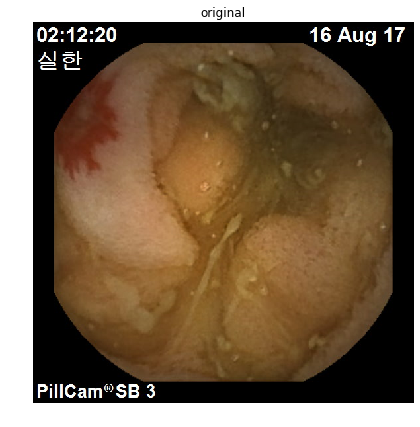

                             ||     s - 30 / v - 30    ||      s - 30 / v + 30     ||     s + 30 / v - 30     ||    s + 30 / v + 30
   (cropped)                 ||
   ab                        ||
   mb                        ||
   eh                        ||
   r1                        ||
   r1 + ab                   ||
   r1 + mb                   ||
   r1 + eh                   ||
   r2                        ||
    .                        ||
    .                        ||
    .                        ||
   f + r3                    ||
   f + r3 + ab               ||
   f + r3 + mb               ||
   f + r3 + eh               ||


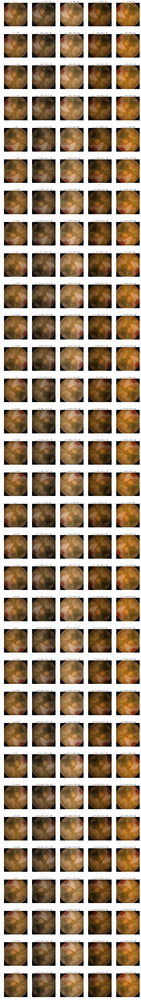

In [854]:
plt.figure(figsize=(7, 7))
plt.title('original')
plt.imshow(cv2.cvtColor(test, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

print("                             ||     s - 30 / v - 30    ||      s - 30 / v + 30     ||     s + 30 / v - 30     ||    s + 30 / v + 30")
print("   (cropped)                 ||")
print("   ab                        ||")
print("   mb                        ||")
print("   eh                        ||")
print("   r1                        ||")
print("   r1 + ab                   ||")
print("   r1 + mb                   ||")
print("   r1 + eh                   ||")
print("   r2                        ||")
print("    .                        ||")
print("    .                        ||")
print("    .                        ||")
print("   f + r3                    ||")
print("   f + r3 + ab               ||")
print("   f + r3 + mb               ||")
print("   f + r3 + eh               ||")

plt.figure(figsize = (20, 150))
for i, p_img, p_n in zip(range(1, 161), test_pre, pre_name):
    plt.subplot(32, 5, i)
    plt.title(p_n)
    plt.imshow(cv2.cvtColor(p_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
#     if i % 5 != 1:
#         plt.subplot(32, 4, i - ((i-1)//5 + 1))
#         plt.title(p_n)
#         plt.imshow(cv2.cvtColor(p_img, cv2.COLOR_BGR2RGB))
#         plt.axis('off')
plt.show()